In [ ]:
### install dependencies:
 
# might need to install opencv
!pip3 install Cython cupy-cuda112 cupy-cuda102   # Probably only need one of these but it works so I'm gonna leave it for now.
!pip3 install pyyaml==5.1
 
# Torch 1.8.1 does not work despite being the latest stable release. As such, use 1.7. 
# Cuda version on MAGEOHub is currently 11.3 - cu110 all works fine.
 
# To be tried once the bug with torch 1.8 has been fixed 
#!pip3 install torch==1.8.1+cu111 torchvision==0.9.1+cu111 torchaudio==0.8.1 -f https://download.pytorch.org/whl/torch_stable.html
 
!pip install torch==1.7.1+cu110 torchvision==0.8.2+cu110 torchaudio==0.7.2 -f https://download.pytorch.org/whl/torch_stable.html
!python -m pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu110/torch1.7/index.html

Looking in links: https://download.pytorch.org/whl/torch_stable.html
Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu110/torch1.7/index.html


In [ ]:
# Import torch and check versions and cuda availability, and resources
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
!nvcc --version
!nvidia-smi

from IPython.display import display, clear_output

1.7.1+cu110 True
gcc (Ubuntu 7.5.0-3ubuntu1~18.04) 7.5.0
Copyright (C) 2017 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2020 NVIDIA Corporation
Built on Wed_Jul_22_19:09:09_PDT_2020
Cuda compilation tools, release 11.0, V11.0.221
Build cuda_11.0_bu.TC445_37.28845127_0
Thu Aug 12 14:32:35 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 470.42.01    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|======================

In [ ]:
# Some basic imports:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# tensorboard?
#%load_ext tensorboard
#%tensorboard --logdir output

# necessary libraries
import pandas as pd
import numpy as np
import cv2
import random
import matplotlib.pyplot as plt
from PIL import Image
import os
import numpy as np
import json

#from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.structures import BoxMode

In [ ]:
# this mounts your google drive, so you can access files in it

from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Make sure the inevitable error messages are useful.
CUDA_LAUNCH_BLOCKING="1"

In [ ]:
#### This loop gets the labels and images into the correct form for training.

def get_tree_dicts(directory):
    classes = ['tree']
    dataset_dicts = []
    for filename in [file for file in os.listdir(directory) if file.endswith('.geojson')]:
        json_file = os.path.join(directory, filename)
        with open(json_file) as f:
            img_anns = json.load(f)
        
        
        
        record = {}
        
        filename = os.path.join(directory, img_anns["imagePath"])
        # Make sure we have the correct height and width
        height, width = cv2.imread(filename).shape[:2]

        record["file_name"] = filename
        record["height"] = height
        record["width"] = width
        record["image_id"] = filename[0:400]
        print(filename[0:400])
            
        

        objs = []
        for features in img_anns['features']:
            anno = features['geometry']
            # print("##### HERE IS AN ANNO #####", anno)...weirdly sometimes (but not always) have to make 1000 into a np.array
            px = [a[0] for a in anno['coordinates'][0]]
            py = [np.array(height) - a[1] for a in anno['coordinates'][0]]
            # print("### HERE IS PY ###", py)
            poly = [(x, y) for x, y in zip(px, py)]
            poly = [p for x in poly for p in x]
            # print("#### HERE ARE SOME POLYS #####", poly)
            obj = {
                   "bbox": [np.min(px), np.min(py), np.max(px), np.max(py)],
                   "bbox_mode": BoxMode.XYXY_ABS,
                   "segmentation": [poly],
                   "category_id": 0,
                   "iscrowd": 0
                   }
            objs.append(obj)
            # print("#### HERE IS OBJS #####", objs)
        record["annotations"] = objs
        dataset_dicts.append(record)
    return dataset_dicts

############################
#CHANGE THE FILENAMES HERE!#
train_filename = "train_0.1"
test_filename = "test_0.5"
############################

# Change the file directory too!

from detectron2.data import DatasetCatalog, MetadataCatalog
for d in [train_filename, test_filename]:
    DatasetCatalog.register("trees_" + d, lambda d=d: get_tree_dicts('/content/drive/MyDrive/train_and _test_data/Resolution/' + d))
    MetadataCatalog.get("trees_" + d).set(thing_classes=['tree'])
trees_metadata = MetadataCatalog.get("trees_" + d)

In [ ]:
# Check if the path exists
os.path.isdir("/content/drive/MyDrive/train_and _test_data/Resolution/" + train_filename)

True

In [ ]:
### Setup the evaluator

from detectron2.evaluation import (
    CityscapesInstanceEvaluator,
    CityscapesSemSegEvaluator,
    COCOEvaluator,
    COCOPanopticEvaluator,
    DatasetEvaluators,
    LVISEvaluator,
    PascalVOCDetectionEvaluator,
    SemSegEvaluator,
    verify_results,
)

from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader


In [ ]:
# This block allows us to print loss on the test set as training goes on.

from detectron2.engine.hooks import HookBase
from detectron2.evaluation import inference_context
from detectron2.utils.logger import log_every_n_seconds
from detectron2.data import DatasetMapper, build_detection_test_loader, build_detection_train_loader
import detectron2.utils.comm as comm
#import torch
import time
import datetime
import logging

class LossEvalHook(HookBase):
    def __init__(self, eval_period, model, data_loader):
        self._model = model
        self._period = eval_period
        self._data_loader = data_loader
    
    def _do_loss_eval(self):
        # Copying inference_on_dataset from evaluator.py
        total = len(self._data_loader)
        num_warmup = min(5, total - 1)
            
        start_time = time.perf_counter()
        total_compute_time = 0
        losses = []
        for idx, inputs in enumerate(self._data_loader):            
            if idx == num_warmup:
                start_time = time.perf_counter()
                total_compute_time = 0
            start_compute_time = time.perf_counter()
            if torch.cuda.is_available():
                torch.cuda.synchronize()
            total_compute_time += time.perf_counter() - start_compute_time
            iters_after_start = idx + 1 - num_warmup * int(idx >= num_warmup)
            seconds_per_img = total_compute_time / iters_after_start
            if idx >= num_warmup * 2 or seconds_per_img > 5:
                total_seconds_per_img = (time.perf_counter() - start_time) / iters_after_start
                eta = datetime.timedelta(seconds=int(total_seconds_per_img * (total - idx - 1)))
                log_every_n_seconds(
                    logging.INFO,
                    "Loss on Validation  done {}/{}. {:.4f} s / img. ETA={}".format(
                        idx + 1, total, seconds_per_img, str(eta)
                    ),
                    n=5,
                )
            loss_batch = self._get_loss(inputs)
            losses.append(loss_batch)
        mean_loss = np.mean(losses)
        self.trainer.storage.put_scalar('validation_loss', mean_loss)
        comm.synchronize()

        return losses
            
    def _get_loss(self, data):
        # How loss is calculated on train_loop 
        metrics_dict = self._model(data)
        metrics_dict = {
            k: v.detach().cpu().item() if isinstance(v, torch.Tensor) else float(v)
            for k, v in metrics_dict.items()
        }
        total_losses_reduced = sum(loss for loss in metrics_dict.values())
        return total_losses_reduced
        
        
    def after_step(self):
        next_iter = self.trainer.iter + 1
        is_final = next_iter == self.trainer.max_iter
        if is_final or (self._period > 0 and next_iter % self._period == 0):
            self._do_loss_eval()
        self.trainer.storage.put_scalars(timetest=12)

In [ ]:
# This is repeated below - this shouldn't matter though. This is just instantiating the config. 
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("trees_" + train_filename,)
cfg.DATASETS.TEST = ("trees_"+ test_filename,)
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml")
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.0025
cfg.SOLVER.MAX_ITER = 500
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1

In [ ]:
import detectron2.data.transforms as T
from detectron2.data import DatasetMapper   # the default mapper

dataloader = build_detection_train_loader(cfg,
        mapper=DatasetMapper(cfg, is_train=True, augmentations=[
        T.Resize((800, 800)), 
        T.RandomBrightness(0.8, 1.8),
        T.RandomContrast(0.6, 1.3),
        T.RandomSaturation(0.8, 1.4),
        T.RandomRotation(angle=[90, 90], expand=False),
        T.RandomLighting(0.7),
        T.RandomFlip(prob=0.4, horizontal=False, vertical=True)]))
# use this dataloader instead of the default

[08/12 14:32:36 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in training: [Resize(shape=(800, 800)), RandomBrightness(intensity_min=0.8, intensity_max=1.8), RandomContrast(intensity_min=0.6, intensity_max=1.3), RandomSaturation(intensity_min=0.8, intensity_max=1.4), RandomRotation(angle=[90, 90], expand=False), RandomLighting(scale=0.7), RandomFlip(prob=0.4, horizontal=False, vertical=True)]
/content/drive/MyDrive/train_and _test_data/Resolution/train_0.1/202105_5cm_tile_286920_583980.png
/content/drive/MyDrive/train_and _test_data/Resolution/train_0.1/202104_5cm_tile_286555_583760.png
/content/drive/MyDrive/train_and _test_data/Resolution/train_0.1/2019_10cm_tile_286555_583760.png
/content/drive/MyDrive/train_and _test_data/Resolution/train_0.1/202104_5cm_tile_286740_583840.png
/content/drive/MyDrive/train_and _test_data/Resolution/train_0.1/202105_5cm_tile_286555_583760.png
/content/drive/MyDrive/train_and _test_data/Resolution/train_0.1/2019_10cm_tile_286755_583730.pn

In [ ]:
from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator
import detectron2.data.transforms as T

class MyTrainer(DefaultTrainer):
    @classmethod
    def build_evaluator(cls, cfg, dataset_name, output_folder=None):
        if output_folder is None:
            os.makedirs("eval_2", exist_ok=True)
            output_folder = "eval_2"
        return COCOEvaluator(dataset_name, cfg, True, output_folder)
                     
    def build_hooks(self):
        hooks = super().build_hooks()
        hooks.insert(-1,LossEvalHook(
            cfg.TEST.EVAL_PERIOD,
            self.model,
            build_detection_test_loader(
                self.cfg,
                self.cfg.DATASETS.TEST[0],
                DatasetMapper(self.cfg,True)
            )
        ))
        return hooks

    def build_train_loader(cls, cfg):
        return build_detection_train_loader(cfg, mapper=DatasetMapper(cfg, is_train=True, augmentations=[T.Resize((800, 800)), T.RandomBrightness(0.8, 1.8), 
        T.RandomContrast(0.6, 1.3), T.RandomSaturation(0.8, 1.4), T.RandomRotation(angle=[90, 90], expand=False), T.RandomLighting(0.7),
        T.RandomFlip(prob=0.4, horizontal=False, vertical=True)]))

In [ ]:
# Train! Can change hyperparameters e.g. base learning rate, maximum iterations, images per batch
# This works excellently, 15/6/21.
# This cell will print the network architecture, and a number of metrics of the performance of the model
# on the test set e.g. AP50, as well as metrics on the training set e.g. total loss, loss_cls

from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
 
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("trees_" + train_filename,)
cfg.DATASETS.TEST = ("trees_"+ test_filename,)
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml")
cfg.DATALOADER.NUM_WORKERS = 2
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.GAMMA = 0.1
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 1024
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1
cfg.MODEL.BACKBONE.FREEZE_AT =2
cfg.SOLVER.WARMUP_ITERS = 120
cfg.SOLVER.MOMENTUM = 0.9
cfg.SOLVER.WEIGHT_DECAY = 0.001

# Change this 2 parameters
cfg.SOLVER.BASE_LR = 0.0025            
cfg.SOLVER.MAX_ITER = 250

# Change the number of steps for each evaluation
cfg.TEST.EVAL_PERIOD = 20
 
 
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = MyTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

[08/12 14:32:45 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (2, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (2,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (4, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (4,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.mask_head.predictor.weight' to the model due to incompatible shapes: (80, 256, 1, 1) in the checkpoint but (1, 256, 1, 1) in

[08/12 14:32:52 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.7/dist-packages/detectron2/structures/masks.py:363: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:882.)
  item = item.nonzero().squeeze(1).cpu().numpy().tolist()
/usr/local/lib/python3.7/dist-packages/detectron2/structures/masks.py:363: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:882.)
  item = item.nonzero().squeeze(1).cpu().numpy().tolist()
/usr/local/lib/python3.7/dist-packages/detectron2/modeling/roi_heads/fast_rcnn.py:103: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/

/content/drive/MyDrive/train_and _test_data/Resolution/test_0.5/Sep_2014_RGB_603400_648000_0.5m.png
/content/drive/MyDrive/train_and _test_data/Resolution/test_0.5/Sep_2014_RGB_603400_648100_0.5m.png
/content/drive/MyDrive/train_and _test_data/Resolution/test_0.5/Sep_2014_RGB_603500_648000_0.5m.png
/content/drive/MyDrive/train_and _test_data/Resolution/test_0.5/Sep_2014_RGB_603500_648100_0.5m.png
/content/drive/MyDrive/train_and _test_data/Resolution/test_0.5/Sep_2014_RGB_603600_648000_0.5m.png
/content/drive/MyDrive/train_and _test_data/Resolution/test_0.5/Sep_2014_RGB_603600_648100_0.5m.png
[08/12 14:33:04 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[08/12 14:33:04 d2.data.common]: Serializing 6 elements to byte tensors and concatenating them all ...
[08/12 14:33:05 d2.data.common]: Serialized dataset takes 0.21 MiB
WARNING [08/12 14:33:05 d2.evaluation.coco_evaluati

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

Reusing TensorBoard on port 6006 (pid 2737), started 1:36:03 ago. (Use '!kill 2737' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
# Setup to predict on new images, here setting up for the trees_test dataset, but can also use this setup
# for predicting on individual images as seen 2 cells down

from detectron2.utils.visualizer import ColorMode

# Weights automatically saved to OUTPUT_DIR + model_final.pth following training
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")

# this is threshold confidence of predicted trees to print
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.4  

cfg.DATASETS.TEST = ("trees_"+ test_filename,)
predictor = DefaultPredictor(cfg)

/content/drive/MyDrive/train_and _test_data/Resolution/test_0.5/Sep_2014_RGB_603400_648000_0.5m.png
/content/drive/MyDrive/train_and _test_data/Resolution/test_0.5/Sep_2014_RGB_603400_648100_0.5m.png
/content/drive/MyDrive/train_and _test_data/Resolution/test_0.5/Sep_2014_RGB_603500_648000_0.5m.png
/content/drive/MyDrive/train_and _test_data/Resolution/test_0.5/Sep_2014_RGB_603500_648100_0.5m.png
/content/drive/MyDrive/train_and _test_data/Resolution/test_0.5/Sep_2014_RGB_603600_648000_0.5m.png
/content/drive/MyDrive/train_and _test_data/Resolution/test_0.5/Sep_2014_RGB_603600_648100_0.5m.png


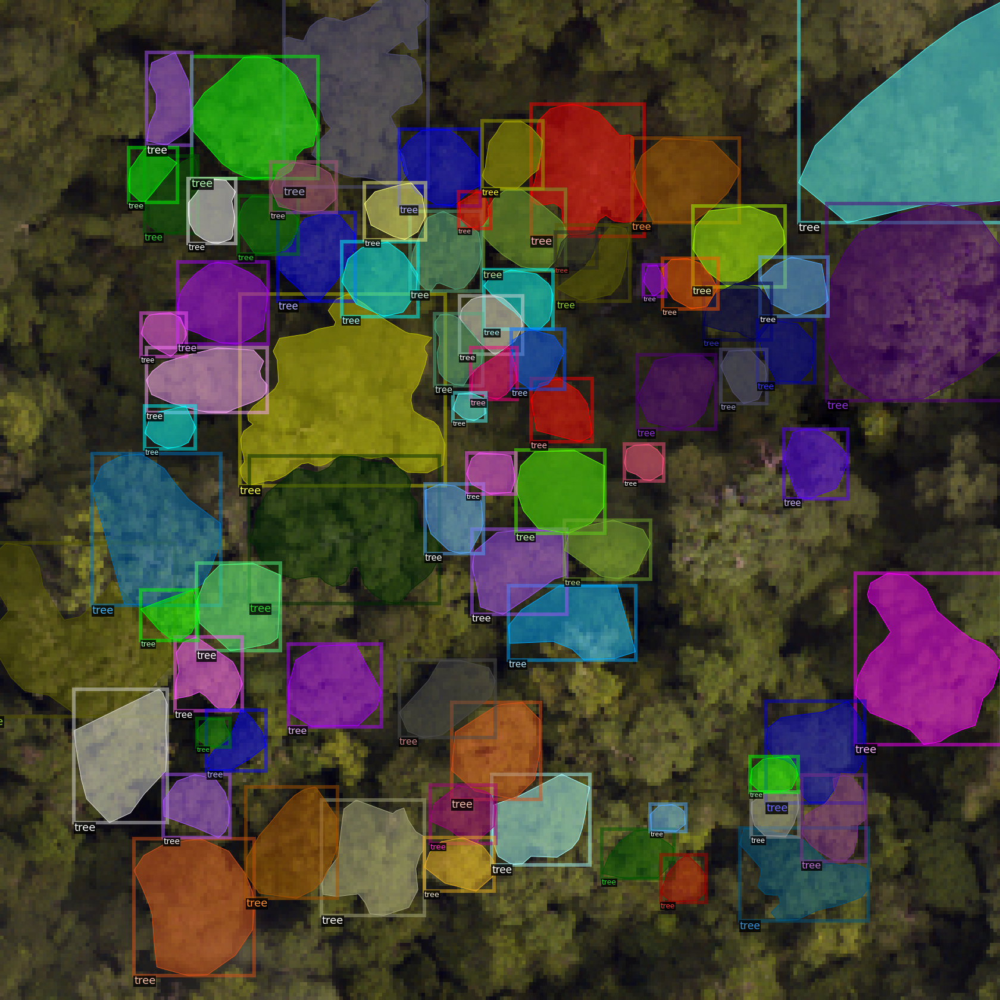

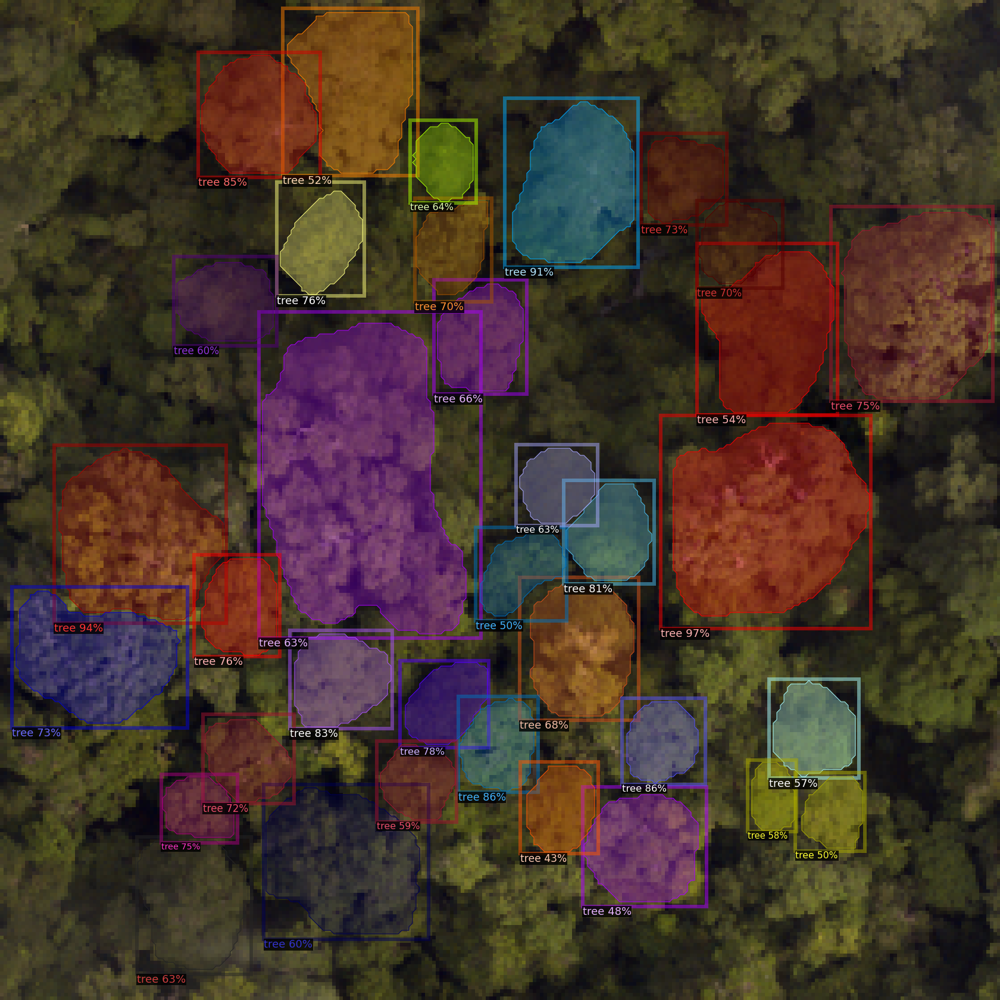

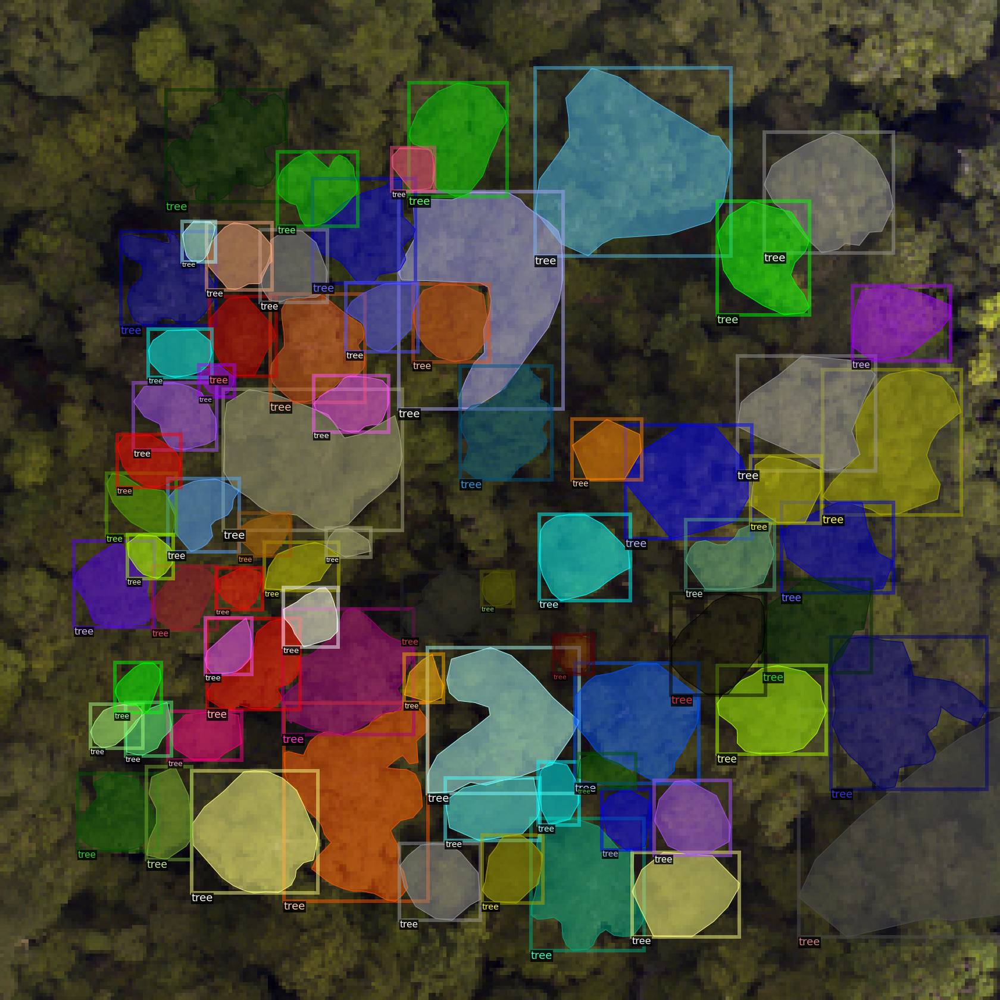

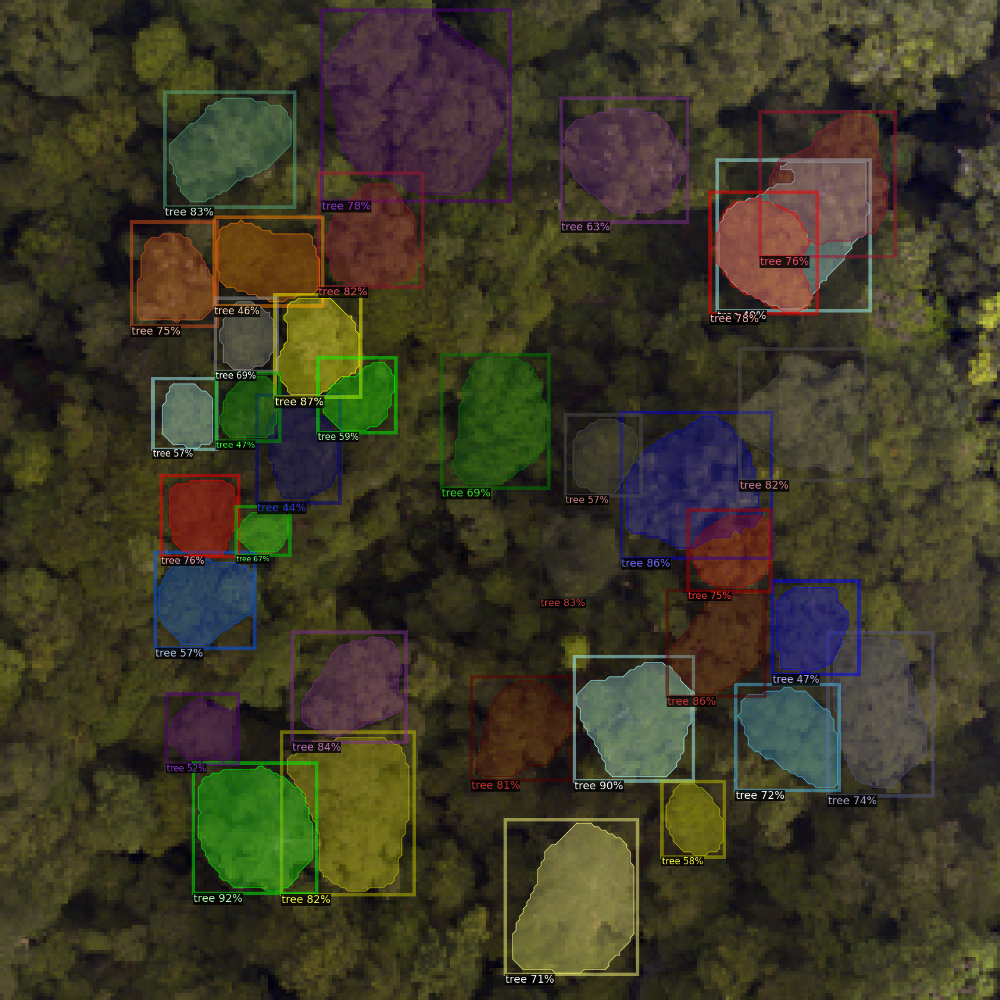

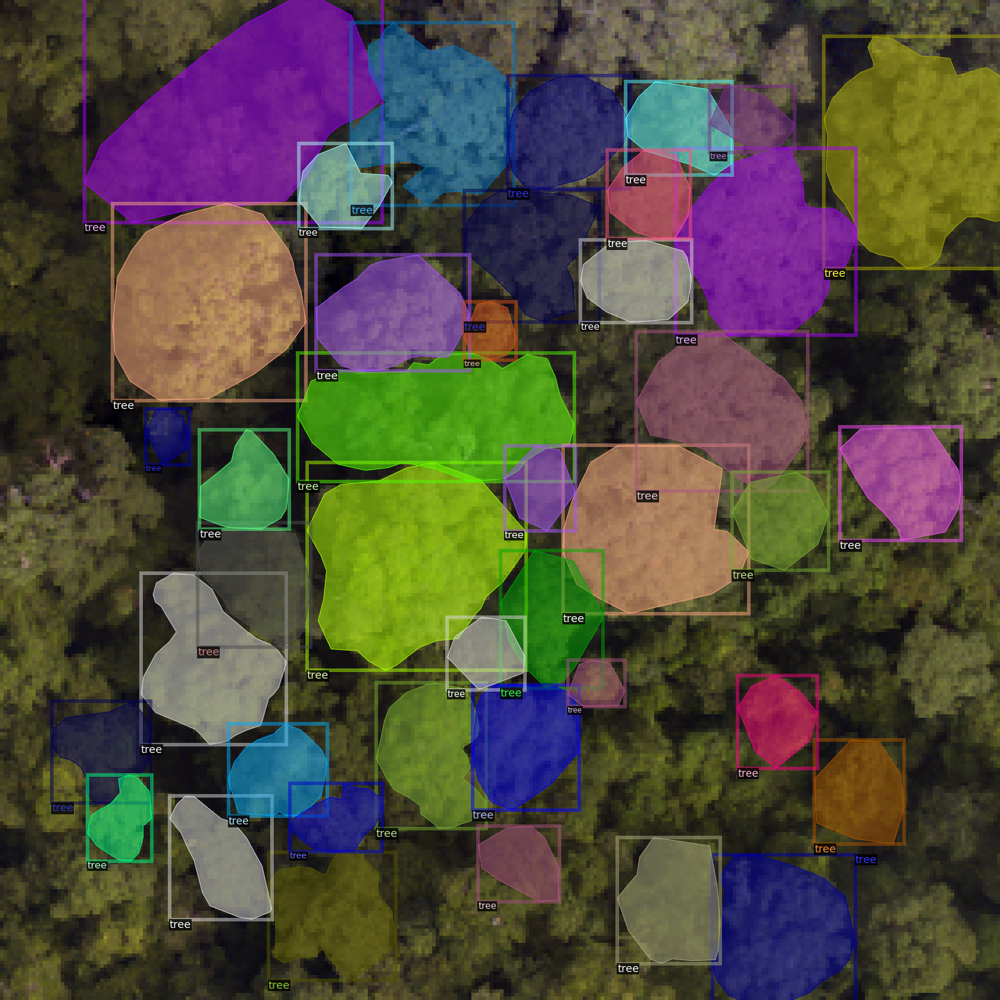

...

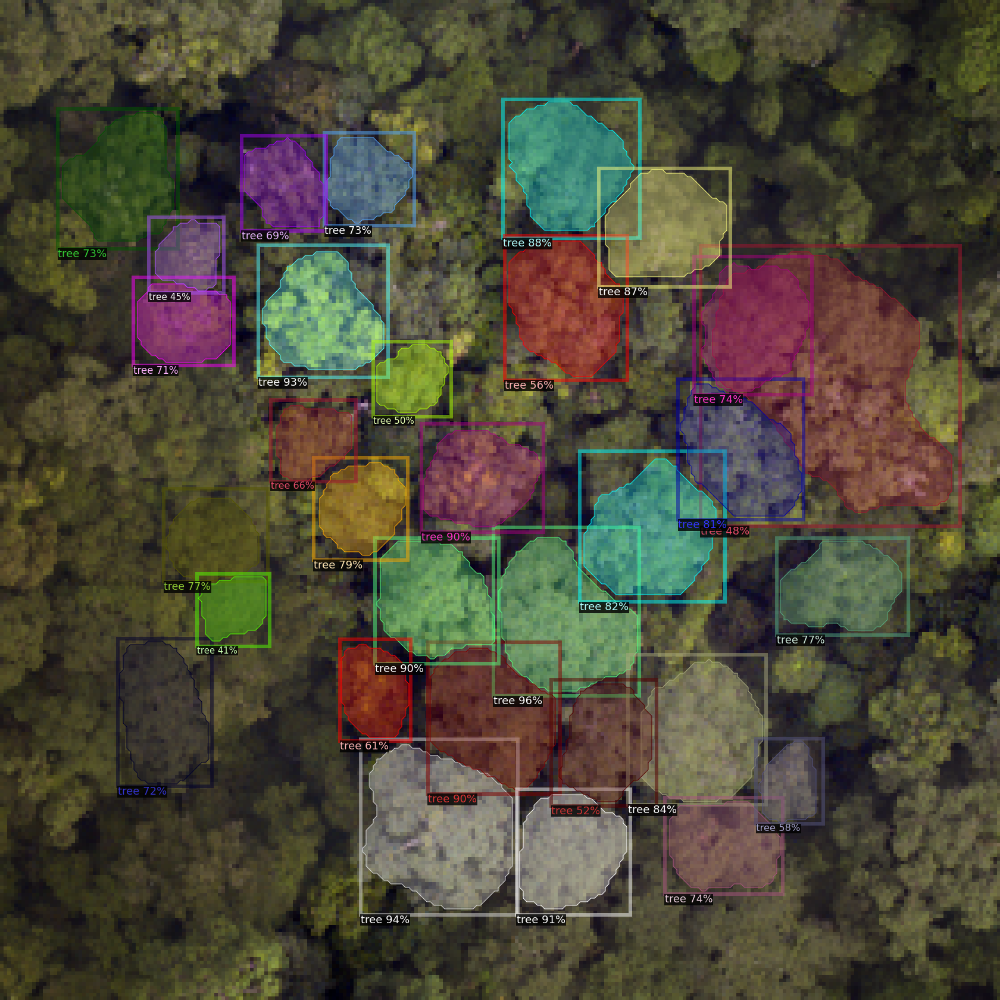

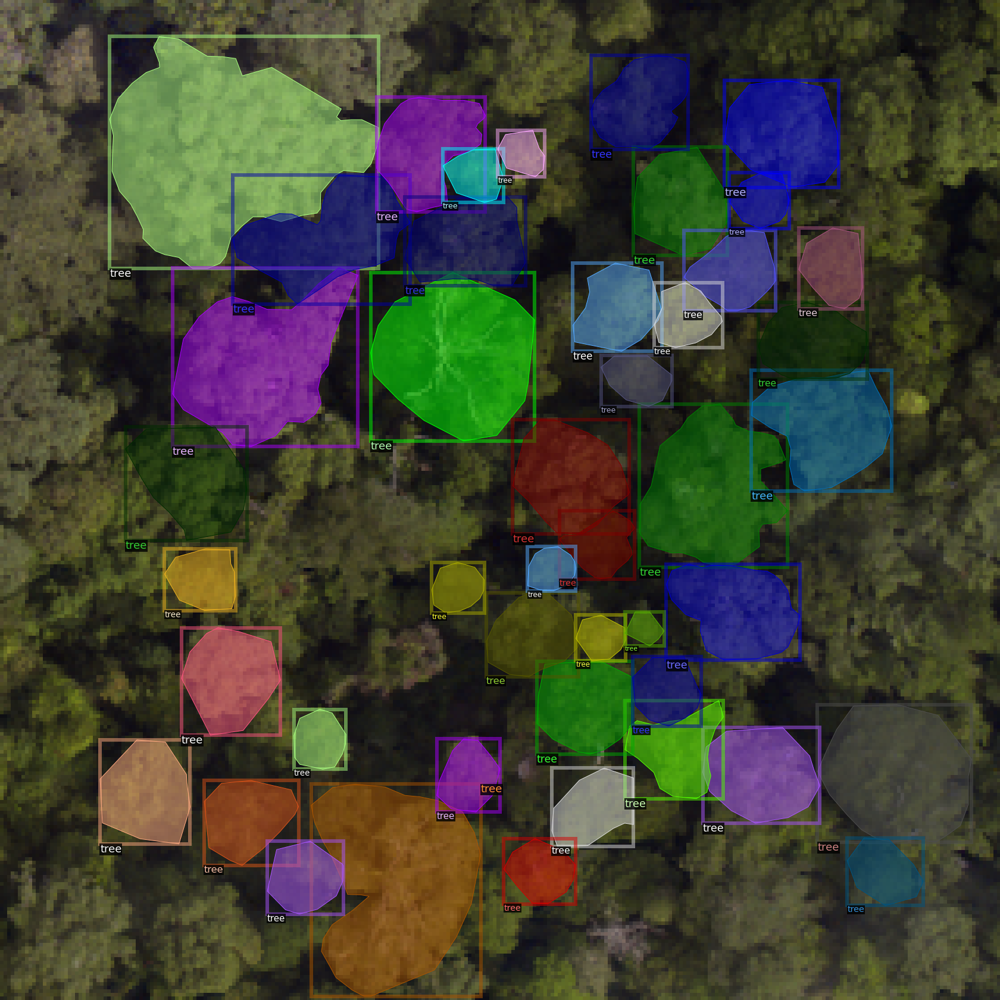

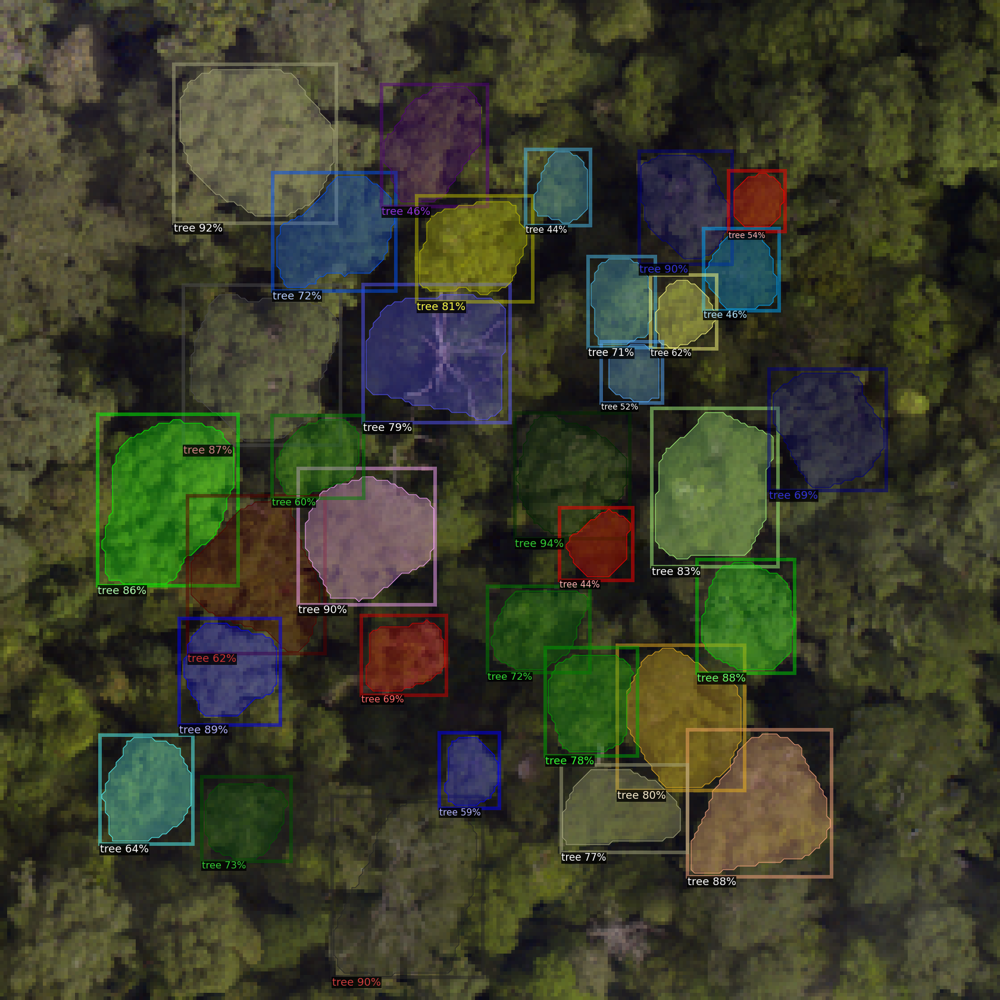

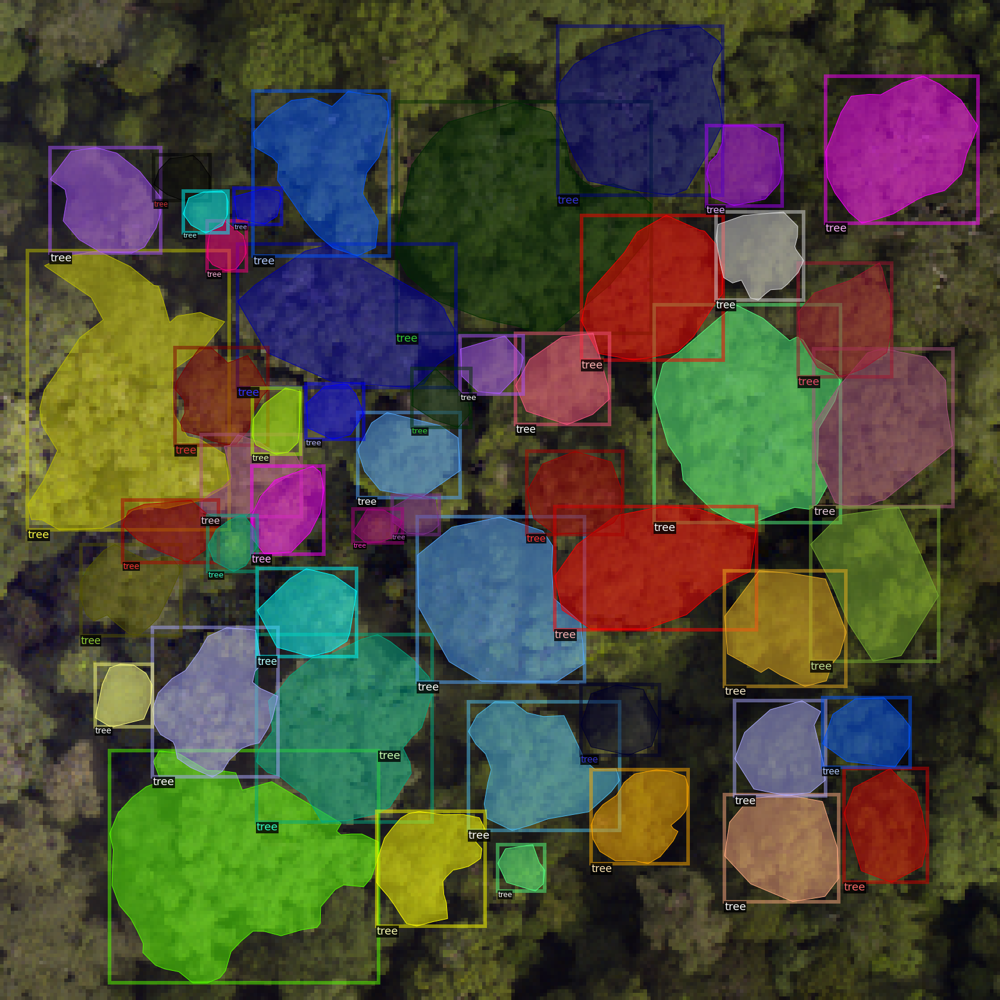

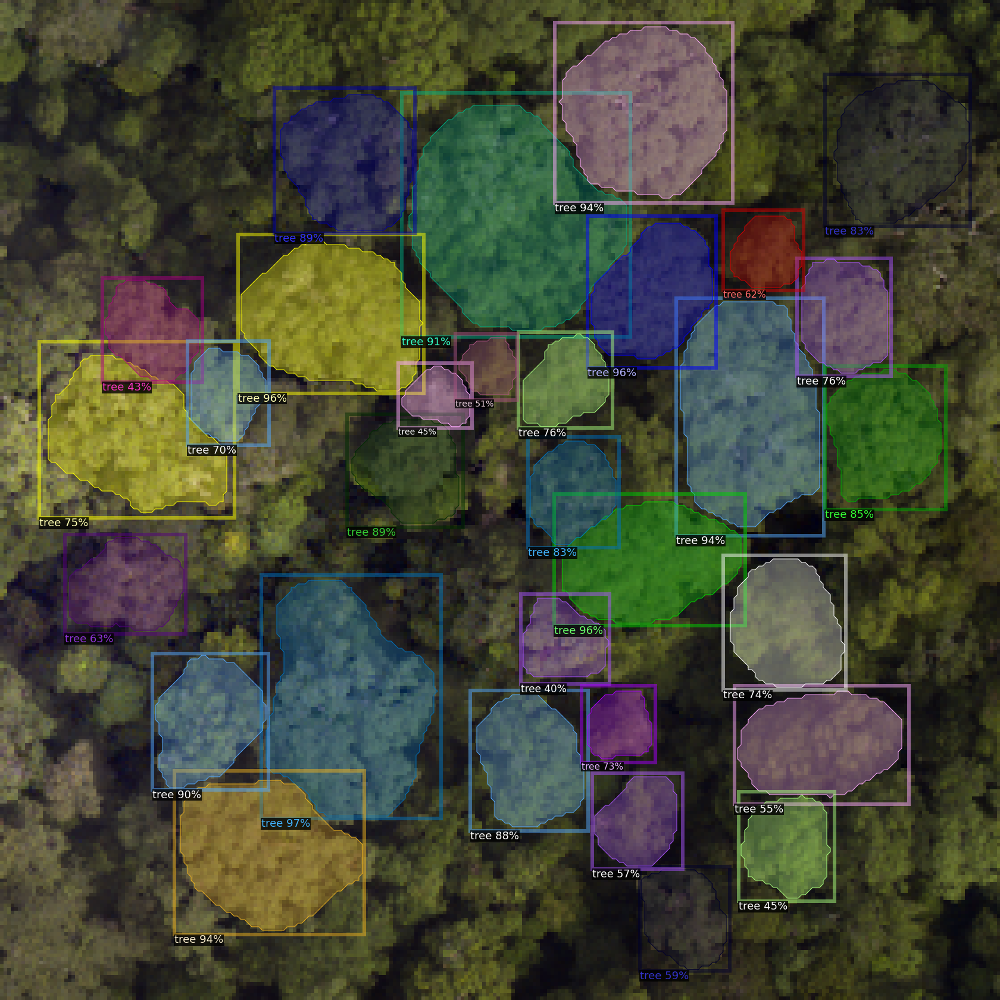

In [ ]:
# Let's look at our prediction on our test Sepilok dataset!!! It will print the manual and predicted ones in alternate sequence.

# Remember to change the path
# Remember to change the scale of the images too
test_dataset_dicts = get_tree_dicts("/content/drive/MyDrive/train_and _test_data/Resolution/" + test_filename)
for d in test_dataset_dicts:
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=trees_metadata, scale=6)
    out = visualizer.draw_dataset_dict(d)
    image = cv2.cvtColor(out.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB)
    display(Image.fromarray(image))

    
    img = cv2.imread(d["file_name"])
    outputs = predictor(img)
    v = Visualizer(img[:, :, ::-1], metadata=trees_metadata, scale=6, instance_mode=ColorMode.IMAGE_BW)  
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    image = cv2.cvtColor(v.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB)
    display(Image.fromarray(image))